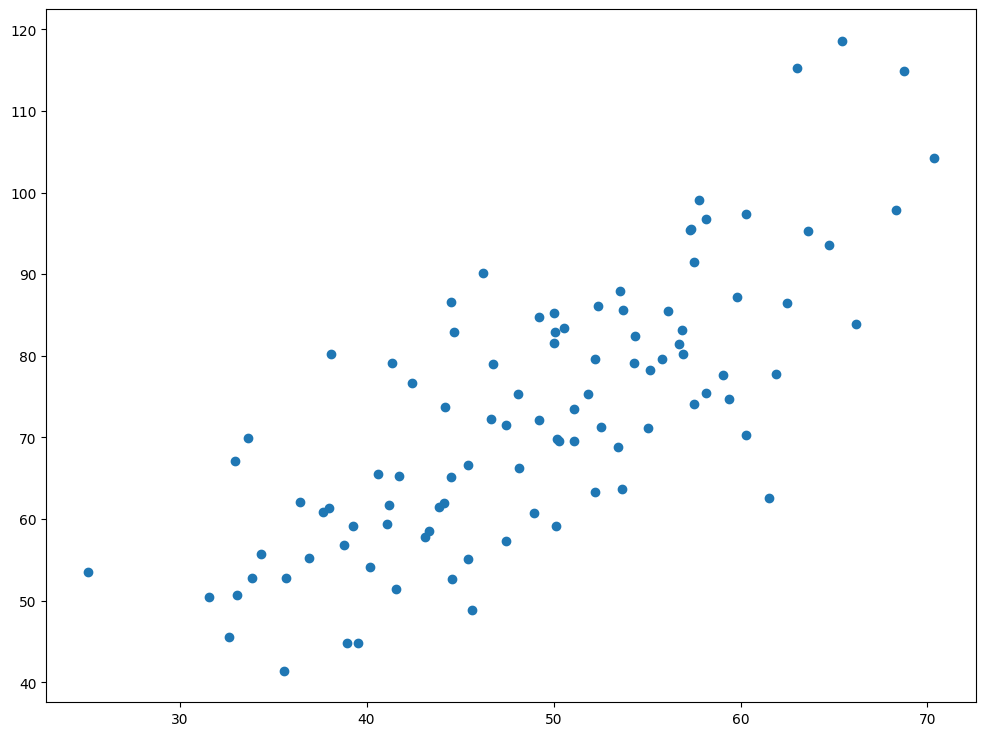

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (12.0, 9.0) # plot figure

# Preprocessing Input data
data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
X = data.iloc[:, 0]
Y = data.iloc[:, 1] 
plt.scatter(X, Y)
plt.show()

1.4796491688889395 0.10148121494753734


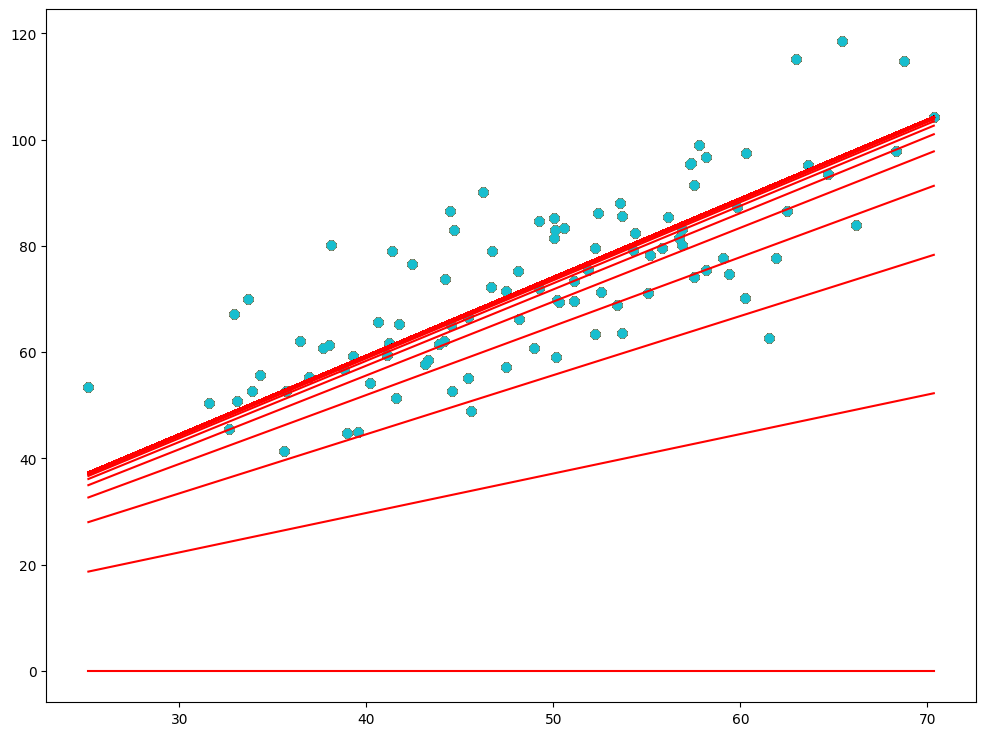

In [2]:
m = 0
c = 0

L = 0.0001  # The learning Rate
epochs = 1000  # The number of iterations to perform gradient descent

n = float(len(X)) # Number of elements in X

# Performing Gradient Descent 
for i in range(epochs): 
    Y_pred = m*X + c  # The current predicted value of Y
    D_m = (-2/n) * sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2/n) * sum(Y - Y_pred)  # Derivative wrt c
    m = m - L * D_m  # Update m
    c = c - L * D_c  # Update c
    plt.scatter(X, Y)
    plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red')
print (m, c)

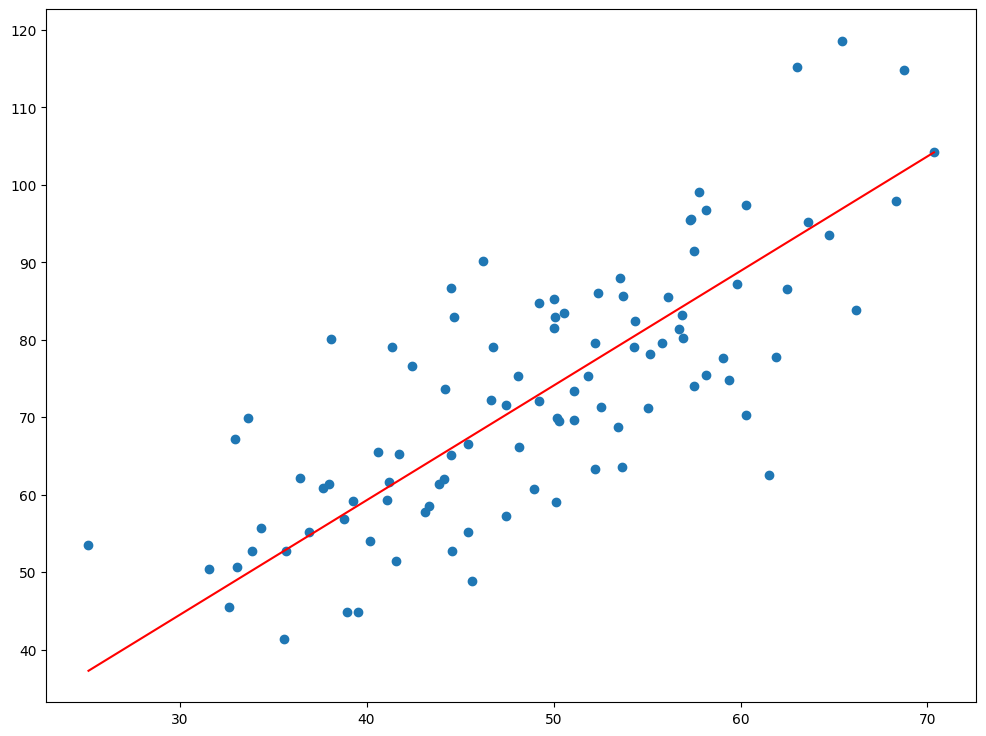

Predicted value : 
0     79.154407
1     91.144824
2     70.348772
3     88.604045
4     81.692574
        ...    
94    74.128587
95    72.959059
96    74.142498
97    71.346380
98    37.282823
Name: 32.502345269453031, Length: 99, dtype: float64


In [3]:
# Making predictions
Y_pred = m*X + c

plt.scatter(X, Y)
plt.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red') # predicted
plt.show()

print('Predicted value : ')
print(Y_pred)

In [4]:
#! pip3 install ffmpeg-python

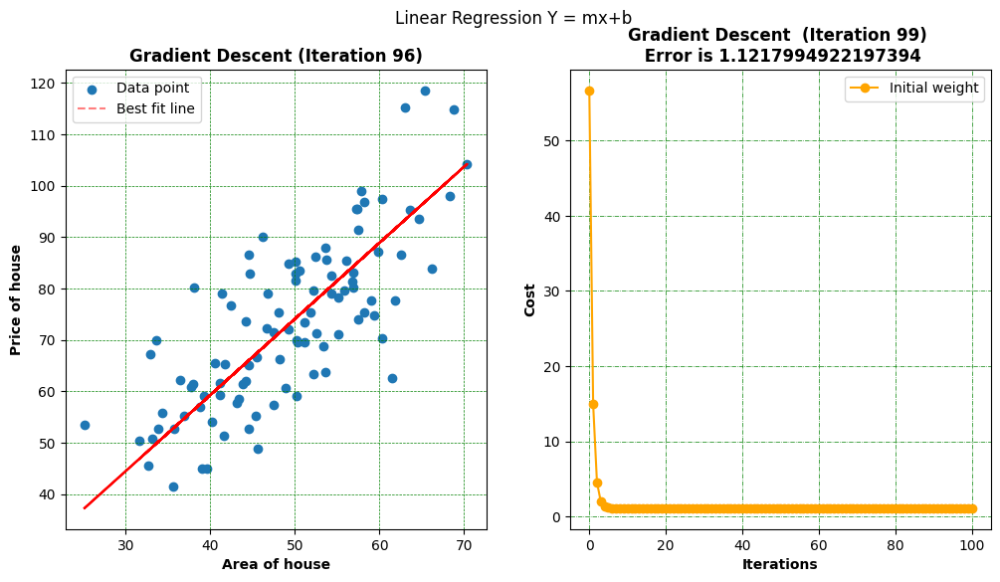

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import display, HTML

def Gradient_descent():
    plt.rcParams['figure.figsize'] = (12.0, 6.0)  # Adjust plot size
    
    # Preprocessing Input data
    data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
    X = data.iloc[:, 0]
    Y = data.iloc[:, 1]

    m = 0 #slope
    c = 0 #intercept
    L = 0.0001  # The learning Rate or Alpha
    epochs = 100  # The number of iterations to perform gradient descent
    n = float(len(X))  # Number of elements in X 

    fig, axs = plt.subplots(1, 2)
    fig.suptitle('Linear Regression Y = mx+b')
    axs[0].set_title('Linear Relationship', weight='bold')
    axs[0].grid()
    axs[0].scatter(X, Y)

    cost_history = []

    def animate(i):
        nonlocal m, c
        Y_pred = m * X + c
        D_m = (-2/n) * sum(X * (Y - Y_pred))
        D_c = (-2/n) * sum(Y - Y_pred)
        m -= L * D_m
        c -= L * D_c

        cost = np.mean(np.square(Y - Y_pred))/X.shape[0]
        cost_history.append(cost)

        axs[1].clear()
        axs[1].set_title(f'Gradient Descent  (Iteration {i}) \n Error is {cost}', weight='bold')
        axs[1].plot(range(len(cost_history)), cost_history, marker='o', color="orange", label='Initial weight')
        axs[1].set_xlabel('Iterations', weight='bold')
        axs[1].set_ylabel('Cost', weight='bold')
        axs[1].grid(color='green', linestyle='-.', linewidth=0.5)
        axs[1].legend()
        axs[0].plot(X, Y_pred, color='red')

        if i % 4 == 0:  # Update the scatter plot after every 10 iterations
            axs[0].clear()
            axs[0].set_title(f'Gradient Descent (Iteration {i})', weight='bold')
            axs[0].grid(color='green', linestyle='--', linewidth=0.5)
            axs[0].scatter(X, Y, label='Data point')
            best_fit_x = np.array([min(X), max(X)])
            best_fit_y = m * best_fit_x + c
            axs[0].plot(best_fit_x, best_fit_y, color='red', alpha=0.5, label='Best fit line', linestyle="--")
            axs[0].set_ylabel('Price of house', weight='bold')
            axs[0].set_xlabel('Area of house', weight='bold')
            axs[0].legend()

    anim = FuncAnimation(fig, animate, frames=epochs, repeat=False)
    display(HTML(anim.to_jshtml()))

if __name__ == "__main__":
    Gradient_descent()


In [7]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50.0
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


def Gradient_descent():
    plt.rcParams['figure.figsize'] = (12.0, 6.0)  # Adjust plot size
    
    # Preprocessing Input data
    data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
    X = data.iloc[:, 0]
    Y = data.iloc[:, 1]

    m = 0  # slope
    c = 0  # intercept
    L = 0.0001  # The learning Rate or Alpha
    epochs = 100  # The number of iterations to perform gradient descent
    n = float(len(X))  # Number of elements in X 

    fig = plt.figure()
    fig.suptitle('Linear Regression Y = mx+b')

    axs = fig.add_subplot(121, projection='3d')
    bxs = fig.add_subplot(122, projection='3d')

    def compute_cost(m, c):
        Y_pred = m * X + c
        cost = np.mean(np.square(Y - Y_pred)) / X.shape[0]
        return cost

    cost_history = []
    m_history = []
    c_history = []

    def update(frame):
        nonlocal m, c

        Y_pred = m * X + c
        D_m = (-2/n) * sum(X * (Y - Y_pred))
        D_c = (-2/n) * sum(Y - Y_pred)
        m -= L * D_m
        c -= L * D_c

        current_cost = compute_cost(m, c)
        cost_history.append(current_cost)
        m_history.append(m)
        c_history.append(c)

        axs.clear()
        axs.set_xlabel('Slope (m)', weight='bold')
        axs.set_ylabel('Intercept (c)', weight='bold')
        axs.set_zlabel('Cost', weight='bold')
        axs.set_title(f'Gradient Descent (Iteration {frame})\n Error is {current_cost}', weight='bold')
        axs.plot(m_history, c_history, cost_history, marker='o', color='blue', label='Optimization Path')

        bxs.clear()
        bxs.set_title(f'Gradient Descent (Iteration {frame})', weight='bold')
        bxs.grid(color='green', linestyle='--', linewidth=0.5)
        bxs.scatter(X, Y, label='Data point')
        bxs.plot([min(X), max(X)], [min(Y_pred), max(Y_pred)], color='red', alpha=0.5, label='Best fit line', linestyle="--")
        bxs.set_ylabel('Price of house', weight='bold')
        bxs.set_xlabel('Area of house', weight='bold')
        bxs.set_zlabel('Predicted Path', weight='bold')
        bxs.legend()

    anim = FuncAnimation(fig, update, frames=epochs, repeat=False)
    plt.close()
    
    return anim

if __name__ == '__main__':
    animation = Gradient_descent()
    display(HTML(animation.to_jshtml()))
